In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
import seaborn as sns
from matplotlib.gridspec import GridSpec
import scanpy as sc
import muon as mu
import graphtools
import magic
from matplotlib.pyplot import rc_context
from matplotlib import gridspec
import os


from datashader.mpl_ext import dsshow
import datashader as ds

import matplotlib.colors
cmap = plt.cm.hsv
cmaplist = [cmap(i) for i in range(cmap.N)]
cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
cmaplist.reverse()
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)

import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

import sys
sys.path.append('../../../Code/')
from utils import read_dataset_log


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
from matplotlib import rcParams, font_manager
import matplotlib


# rcParams['pdf.fonttype'] = 42
# rcParams['ps.fonttype'] = 42
# rcParams['font.family'] = 'sans-serif'
# rcParams['font.sans-serif'] = ['Arial']

In [3]:
params = read_dataset_log('Dataset Paths')
params.index = params['dataset']
params

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,tcat_fn_withsingletons,manual_gating_fn,manual_activation_gating_fn,activation_score_fn,metadata_fn,...,cnmf_dir,k,dt,processed_forcnmf_fn,tpm_counts_for_cnmf_fn,raw_counts_filt_fn,raw_counts_fn,dataset_type,tissue_type,context_label
dataset,,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Manual...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Activa...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,...,/data/srlab1/TCAT/Data/PerDataset/AMPRA,34.0,0_15,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,discovery,Synovium,RA+OA
Pan-Cancer,Pan-Cancer,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Ac...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,...,/data/srlab1/TCAT/Data/PerDataset/Pancancer,38.0,0.15,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,discovery,Pan-Tissue,Cancer+Healthy
TBRU,TBRU,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/TBRU/ManualG...,/data/srlab1/TCAT/Data/PerDataset/TBRU/Activat...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,...,/data/srlab1/TCAT/Data/PerDataset/TBRU,36.0,0_20,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,discovery,Blood,Healthy
HIV-Vaccine,HIV-Vaccine,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Acti...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl,31.0,0_15,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood,Post-Vaccine+Healthy
UK-Covid,UK-Covid,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Acti...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID,44.0,0_20,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood,Covid-19+Healthy
COMBAT,COMBAT,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/

# Prepare markers

In [6]:
outdir = '../../../Data/PerDataset/Sparks2023/'

In [4]:
figdir = '../../../Figures/Components'

In [7]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ForMAGIC.h5ad')
print(outfn)

../../../Data/PerDataset/Sparks2023/ADT_TP10KCLR_ForMAGIC.h5ad


In [8]:
adata_ADT = sc.read(outfn)

In [14]:
dataset = 'Sparks'

In [9]:
adt_markers = ['AB_CD25', 'AB_CD134',
               'AB_CD38', 'AB_CD279', 'AB_CD54', 'AB_CD69', 'AB_CD71', 'AB_CD274', 'AB_CD95']
    
#     'AB_CD3-1', 'AB_CD4-2',
#                'AB_CD8', 'AB_CD45RA', 'AB_CD45RO',  'AB_CD18', 'AB_CD161',  'AB_CD194', 'AB_CD195', 'AB_CD196', 'AB_CXCR3',
#                'AB_CD25', 'AB_CD127', 
#                'AB_CD27-1',
#                'AB_TCR-Vd2', 'AB_TCR-V-7.2', 'AB_TCR-V-9', 'AB_abTCR', 'AB_gdTCR',
#                'AB_CD31', 'AB_CD62L', 'AB_CCR7',
#                'AB_CD314',
#                'AB_CD38-1', 'AB_CD39',
#               'AB_CD94', 'AB_CD49b', 'AB_CD28'
              # ] 
    

In [7]:
sorted(adata_ADT.var.index)

['AB_ArmenianHamsterIgGiso',
 'AB_CD101',
 'AB_CD103',
 'AB_CD105',
 'AB_CD107a',
 'AB_CD112',
 'AB_CD119',
 'AB_CD11a',
 'AB_CD11b',
 'AB_CD11c',
 'AB_CD122',
 'AB_CD123',
 'AB_CD124',
 'AB_CD127',
 'AB_CD13',
 'AB_CD134',
 'AB_CD137',
 'AB_CD14',
 'AB_CD141',
 'AB_CD146',
 'AB_CD152',
 'AB_CD154',
 'AB_CD155',
 'AB_CD158',
 'AB_CD158b',
 'AB_CD158e1',
 'AB_CD16',
 'AB_CD161',
 'AB_CD163',
 'AB_CD169',
 'AB_CD18',
 'AB_CD183',
 'AB_CD185',
 'AB_CD19',
 'AB_CD194',
 'AB_CD195',
 'AB_CD196',
 'AB_CD1c',
 'AB_CD1d',
 'AB_CD2',
 'AB_CD20',
 'AB_CD21',
 'AB_CD22',
 'AB_CD223',
 'AB_CD224',
 'AB_CD226',
 'AB_CD23',
 'AB_CD24',
 'AB_CD244',
 'AB_CD25',
 'AB_CD26',
 'AB_CD267',
 'AB_CD268',
 'AB_CD27',
 'AB_CD270',
 'AB_CD272',
 'AB_CD274',
 'AB_CD278',
 'AB_CD279',
 'AB_CD28',
 'AB_CD29',
 'AB_CD3',
 'AB_CD303',
 'AB_CD31',
 'AB_CD314',
 'AB_CD319',
 'AB_CD32',
 'AB_CD328',
 'AB_CD33',
 'AB_CD335',
 'AB_CD35',
 'AB_CD352',
 'AB_CD36',
 'AB_CD38',
 'AB_CD39',
 'AB_CD4',
 'AB_CD40',
 'AB_CD41'

In [54]:
set(adt_markers) - set(adata_ADT.var.index)

set()

In [84]:
adt_markers = list(set(adt_markers).intersection(adata_ADT.var.index))

In [85]:
G = graphtools.Graph(data=adata_ADT.obsp['connectivities'], precomputed='affinity')
magic_operator = magic.MAGIC(t=3)
magic_operator.fit(adata_ADT.X, graph=G)
markers_magic_adt = magic_operator.transform(X=adata_ADT[:, adt_markers].X)
markers_magic_adt = pd.DataFrame(markers_magic_adt, index=adata_ADT.obs.index, columns=adt_markers)

Running MAGIC on 336739 cells and 138 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/graphtools/base.py:554: RuntimeWarning: K should have a non-zero diagonal
  warnings.warn("K should have a non-zero diagonal", RuntimeWarning)
/PHShome/mc1070/.local/lib/python3.7/site-packages/magic/magic.py:546: UserWarning: Running MAGIC.transform on different data to that which was used for MAGIC.fit may not produce sensible output, unless it comes from the same manifold.
  UserWarning,


Calculated imputation in 0.17 seconds.


In [12]:
markers_magic_adt

,AB_CD69,AB_CD279,AB_CD25,AB_CD134,AB_CD54,AB_CD71,AB_CD38
Batch1_COVFLU_CITE_multi5P09_GCATGCGCAGCCTATA-1,2.845387,4.818857,2.864270,4.773458,1.513752,1.447915,3.192227
Batch1_COVFLU_CITE_multi5P02_TTGTAGGCAGTATCTG-1,2.514501,4.253608,2.523391,3.997067,1.430461,1.166069,1.510149
Batch1_COVFLU_CITE_multi5P02_GATGCTACAGCTTAAC-1,2.727530,4.391587,1.735709,4.363234,1.321352,1.691259,2.944820
Batch1_COVFLU_CITE_multi5P03_AGGGTGACATTAGGCT-1,2.641277,5.178686,1.646153,4.166219,2.111480,1.753519,1.746179
Batch1_COVFLU_CITE_multi5P10_GAACCTACAACGCACC-1,3.154518,5.462848,2.506926,5.005981,1.950984,1.537046,1.489507
...,...,...,...,...,...,...,...
Batch3_COVFLU_CITE_multi5P16_TTCGAAGGTCTCTTTA-1,3.027026,4.862207,1.506565,4.507684,2.840222,1.762128,1.402512
Batch3_COVFLU_CITE_multi5P09_CTCGTACGTAGGACAC-1,2.390922,4.564028,2.118614,4.258863,1.416712,1.308359,2.303494
Batch3_COVFLU_CITE_multi5P09_ACGGCCACAAGAAGAG-1,2.966437,4.510186,2.301069,4.935730,2.186411,1.768403,1.403816
Batch3_COVFLU_CITE_multi5P07_GAGTCCGCACACAGAG-1,2.679222,4.670007,1.397726,4.488341,1.106757,1.793856,4.570844


In [86]:
markers_magic = markers_magic_adt

In [87]:
outfn = os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/Sparks2023/MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [88]:
markers_magic.to_csv(outfn, sep='\t')

In [89]:
unsmoothed_markers = pd.DataFrame(np.array(adata_ADT[:, adt_markers].X), 
                                  index=adata_ADT.obs.index,
                         columns=adt_markers)



In [90]:
outfn = os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/Sparks2023/UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [91]:
unsmoothed_markers.to_csv(outfn, sep='\t')

# Gate on markers

In [10]:
markers_magic = pd.read_csv(os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [11]:
unsmoothed_markers = pd.read_csv(os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [12]:
from scipy.stats import pearsonr
from scipy.stats import spearmanr

## All cells

AB_CD274 AB_CD274
AB_CD274 AB_CD69
AB_CD274 AB_CD279
AB_CD274 AB_CD25
AB_CD274 AB_CD134
AB_CD274 AB_CD54
AB_CD274 AB_CD71
AB_CD274 AB_CD38
AB_CD69 AB_CD274
AB_CD69 AB_CD69
AB_CD69 AB_CD279
AB_CD69 AB_CD25
AB_CD69 AB_CD134
AB_CD69 AB_CD54
AB_CD69 AB_CD71
AB_CD69 AB_CD38
AB_CD279 AB_CD274
AB_CD279 AB_CD69
AB_CD279 AB_CD279
AB_CD279 AB_CD25
AB_CD279 AB_CD134
AB_CD279 AB_CD54
AB_CD279 AB_CD71
AB_CD279 AB_CD38
AB_CD25 AB_CD274
AB_CD25 AB_CD69
AB_CD25 AB_CD279
AB_CD25 AB_CD25
AB_CD25 AB_CD134
AB_CD25 AB_CD54
AB_CD25 AB_CD71
AB_CD25 AB_CD38
AB_CD134 AB_CD274
AB_CD134 AB_CD69
AB_CD134 AB_CD279
AB_CD134 AB_CD25
AB_CD134 AB_CD134
AB_CD134 AB_CD54


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":


AB_CD134 AB_CD71
AB_CD134 AB_CD38
AB_CD54 AB_CD274
AB_CD54 AB_CD69
AB_CD54 AB_CD279
AB_CD54 AB_CD25
AB_CD54 AB_CD134
AB_CD54 AB_CD54
AB_CD54 AB_CD71
AB_CD54 AB_CD38
AB_CD71 AB_CD274
AB_CD71 AB_CD69
AB_CD71 AB_CD279
AB_CD71 AB_CD25
AB_CD71 AB_CD134
AB_CD71 AB_CD54
AB_CD71 AB_CD71
AB_CD71 AB_CD38
AB_CD38 AB_CD274
AB_CD38 AB_CD69
AB_CD38 AB_CD279
AB_CD38 AB_CD25
AB_CD38 AB_CD134
AB_CD38 AB_CD54
AB_CD38 AB_CD71
AB_CD38 AB_CD38


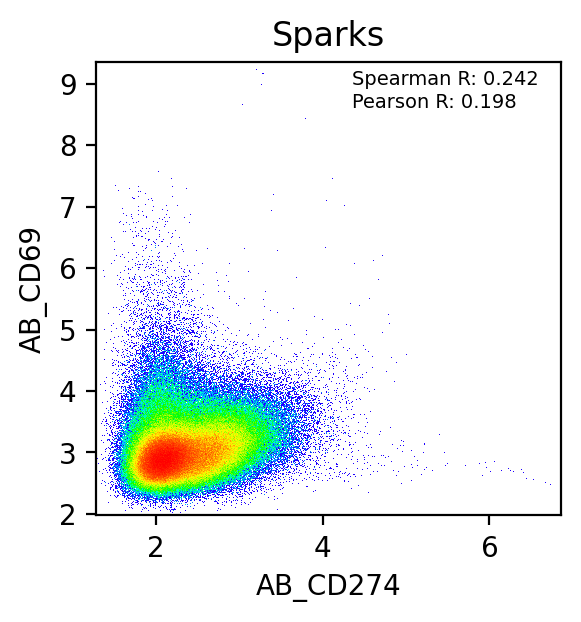

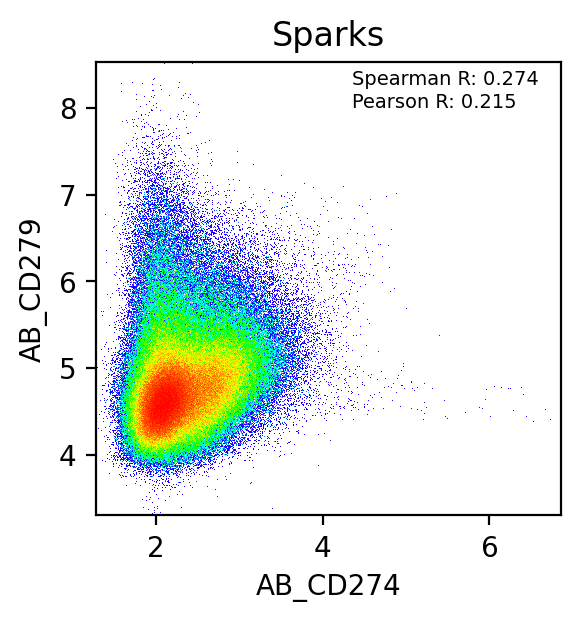

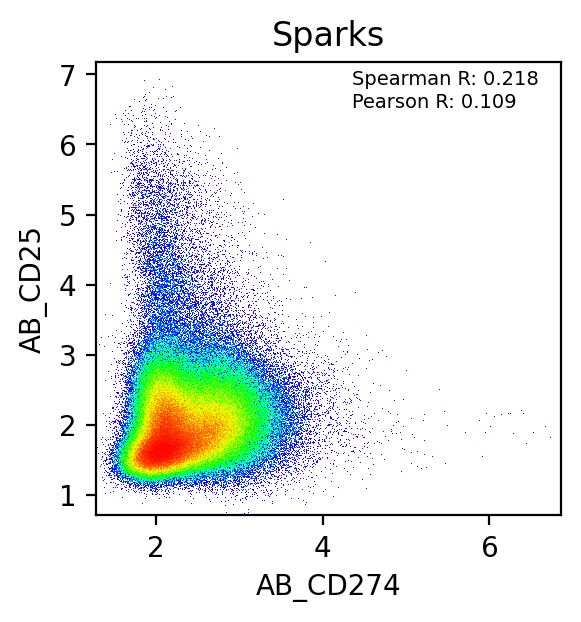

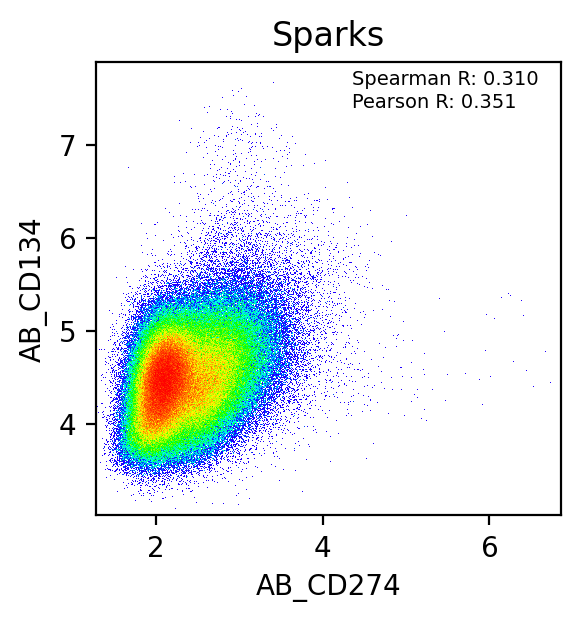

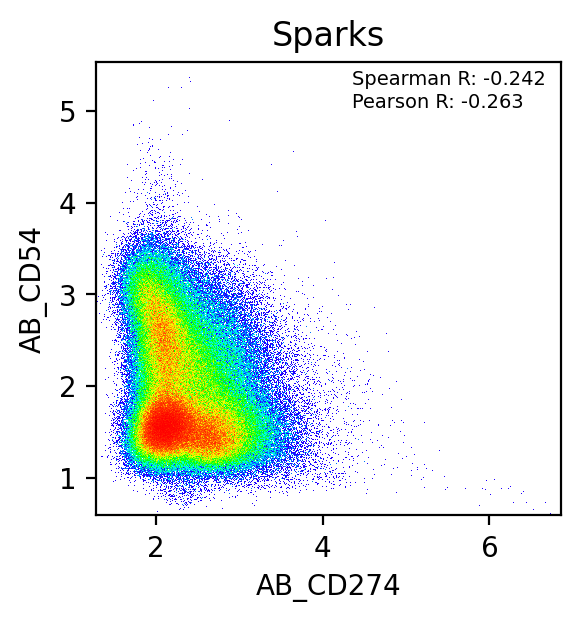

...

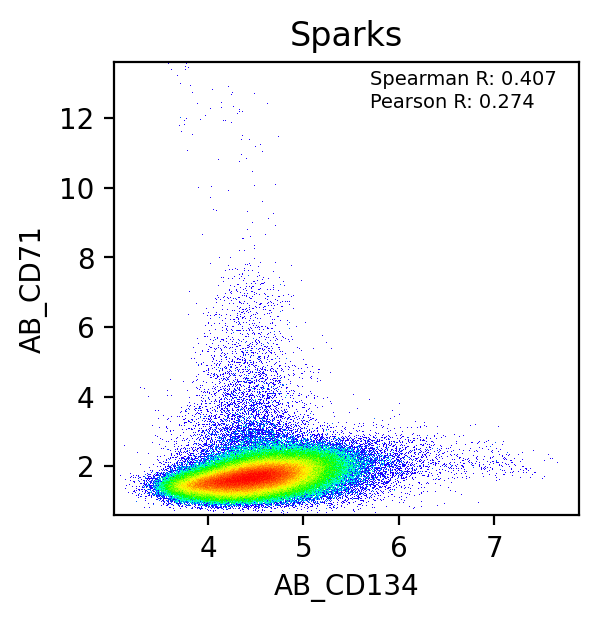

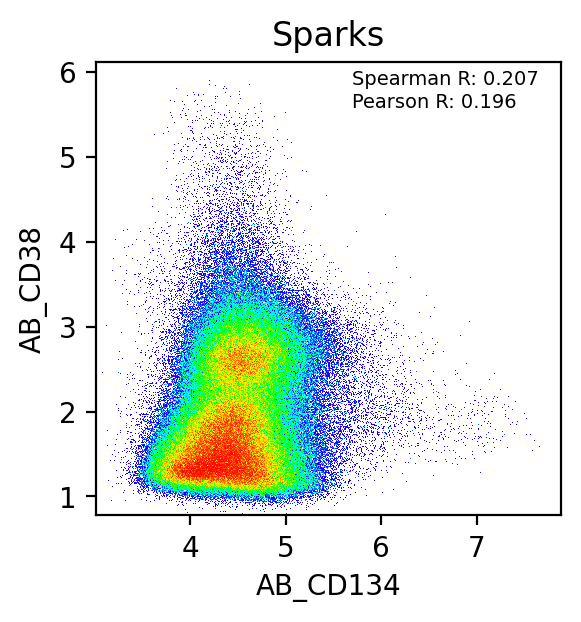

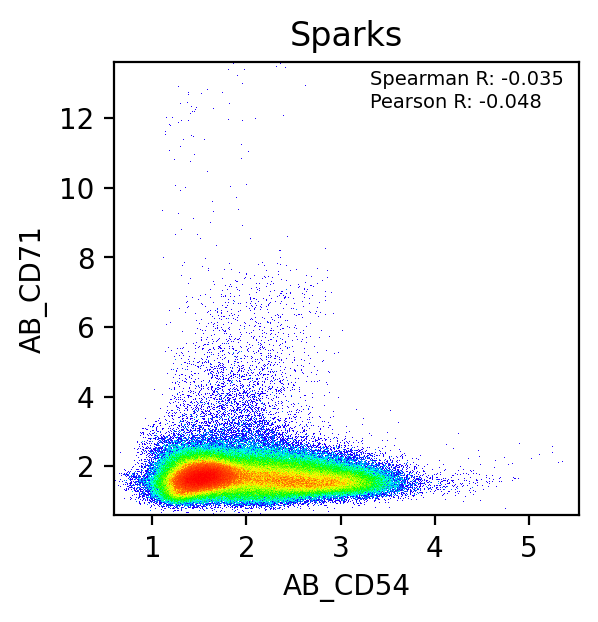

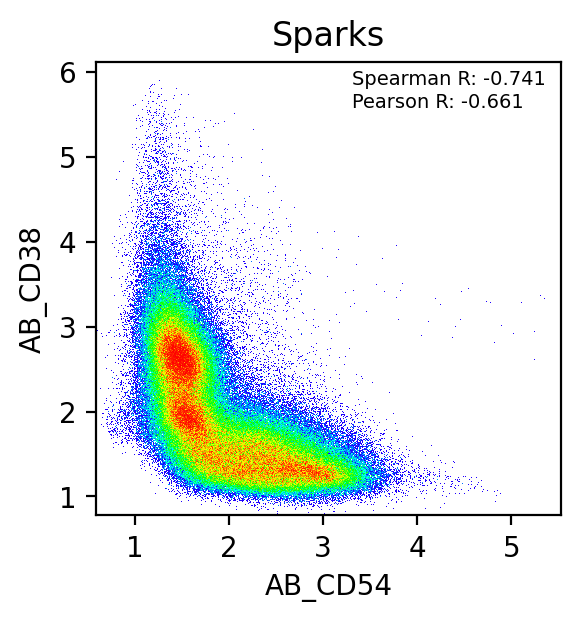

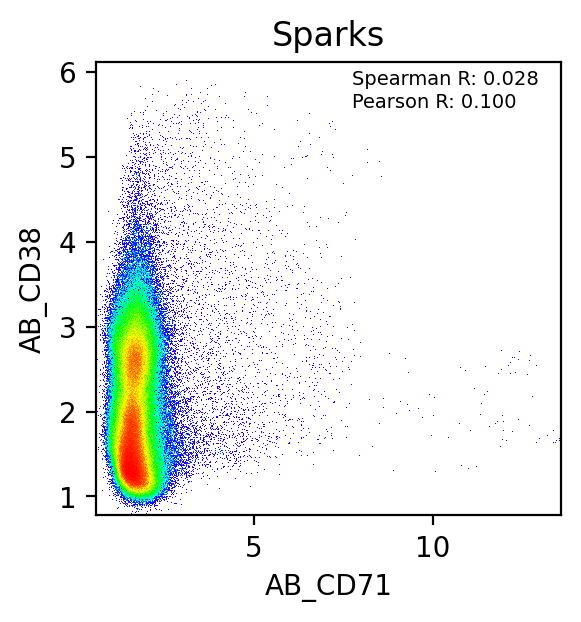

In [66]:
for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title('Sparks')

0 AB_CD274
0 AB_CD274
1 AB_CD274
2 AB_CD274
3 AB_CD274
4 AB_CD274
5 AB_CD274
6 AB_CD274
7 AB_CD274
1 AB_CD69
1 AB_CD69
2 AB_CD69
3 AB_CD69
4 AB_CD69
5 AB_CD69
6 AB_CD69
7 AB_CD69
2 AB_CD279
2 AB_CD279
3 AB_CD279
4 AB_CD279
5 AB_CD279
6 AB_CD279
7 AB_CD279
3 AB_CD25
3 AB_CD25
4 AB_CD25
5 AB_CD25
6 AB_CD25
7 AB_CD25
4 AB_CD134
4 AB_CD134
5 AB_CD134
6 AB_CD134
7 AB_CD134
5 AB_CD54
5 AB_CD54
6 AB_CD54
7 AB_CD54
6 AB_CD71
6 AB_CD71
7 AB_CD71
7 AB_CD38
7 AB_CD38


Text(0.5, 0.9, 'Sparks')

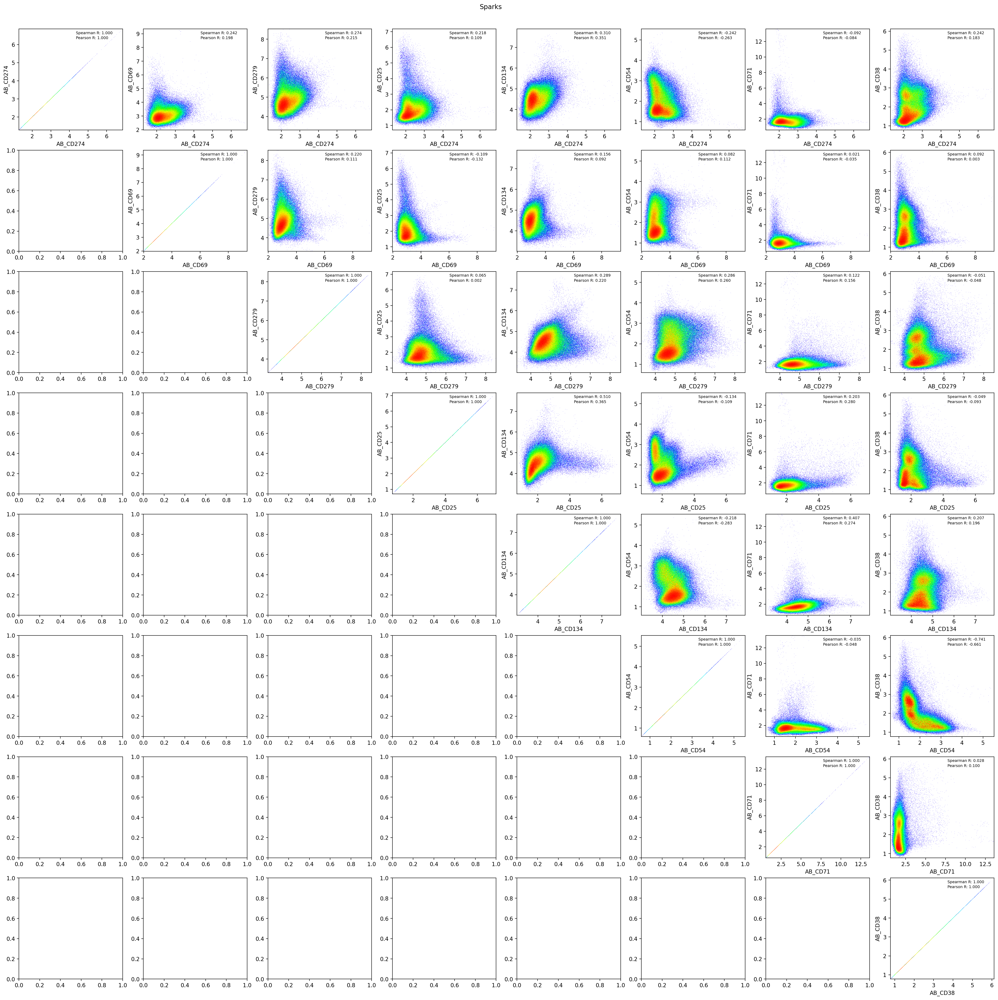

In [68]:
nrows = len(markers_magic.columns)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                               nrows = nrows, ncols = ncols)

for i, p1 in enumerate(markers_magic.columns):
    print(i, p1)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # j = j-1
        if j >= i:
            print(j, p1)
            ax = axes[i, j]
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
plt.suptitle('Sparks',y = 0.9)

AB_CD274 AB_CD274
AB_CD274 AB_CD69
AB_CD274 AB_CD279
AB_CD274 AB_CD25
AB_CD274 AB_CD134
AB_CD274 AB_CD54
AB_CD274 AB_CD71
AB_CD274 AB_CD38
AB_CD69 AB_CD274
AB_CD69 AB_CD69
AB_CD69 AB_CD279
AB_CD69 AB_CD25
AB_CD69 AB_CD134
AB_CD69 AB_CD54
AB_CD69 AB_CD71
AB_CD69 AB_CD38
AB_CD279 AB_CD274
AB_CD279 AB_CD69
AB_CD279 AB_CD279
AB_CD279 AB_CD25
AB_CD279 AB_CD134
AB_CD279 AB_CD54
AB_CD279 AB_CD71
AB_CD279 AB_CD38
AB_CD25 AB_CD274
AB_CD25 AB_CD69
AB_CD25 AB_CD279
AB_CD25 AB_CD25
AB_CD25 AB_CD134
AB_CD25 AB_CD54
AB_CD25 AB_CD71


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":


AB_CD25 AB_CD38
AB_CD134 AB_CD274
AB_CD134 AB_CD69
AB_CD134 AB_CD279
AB_CD134 AB_CD25
AB_CD134 AB_CD134
AB_CD134 AB_CD54
AB_CD134 AB_CD71
AB_CD134 AB_CD38
AB_CD54 AB_CD274
AB_CD54 AB_CD69
AB_CD54 AB_CD279
AB_CD54 AB_CD25
AB_CD54 AB_CD134
AB_CD54 AB_CD54
AB_CD54 AB_CD71
AB_CD54 AB_CD38
AB_CD71 AB_CD274
AB_CD71 AB_CD69
AB_CD71 AB_CD279
AB_CD71 AB_CD25
AB_CD71 AB_CD134
AB_CD71 AB_CD54
AB_CD71 AB_CD71
AB_CD71 AB_CD38
AB_CD38 AB_CD274
AB_CD38 AB_CD69
AB_CD38 AB_CD279
AB_CD38 AB_CD25
AB_CD38 AB_CD134
AB_CD38 AB_CD54
AB_CD38 AB_CD71
AB_CD38 AB_CD38


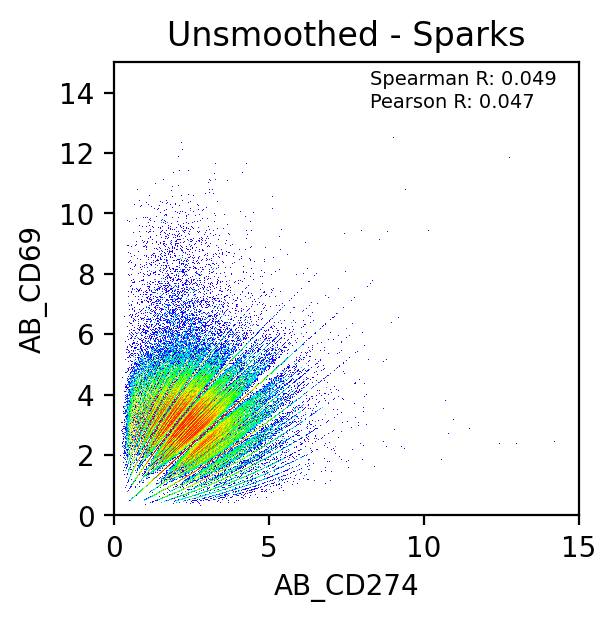

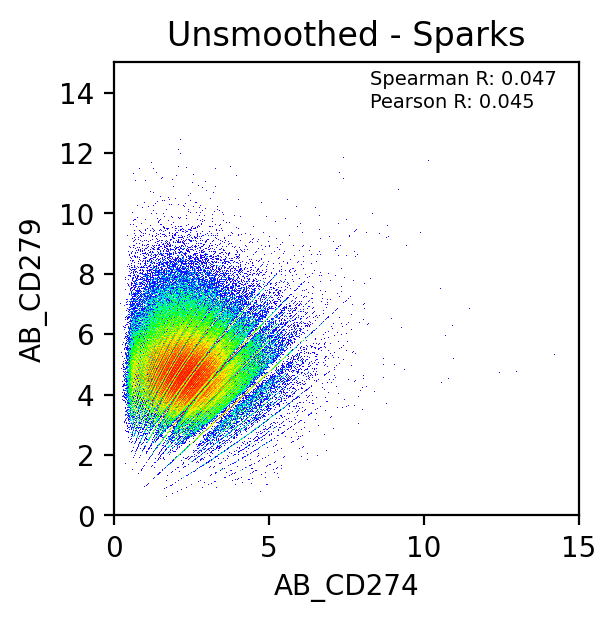

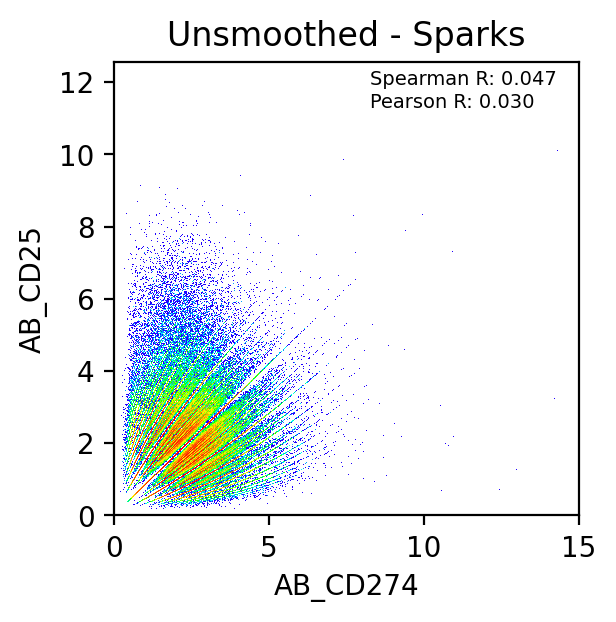

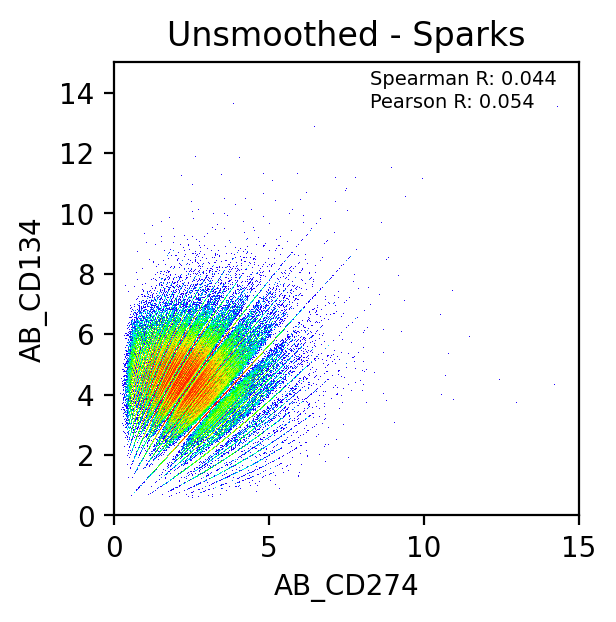

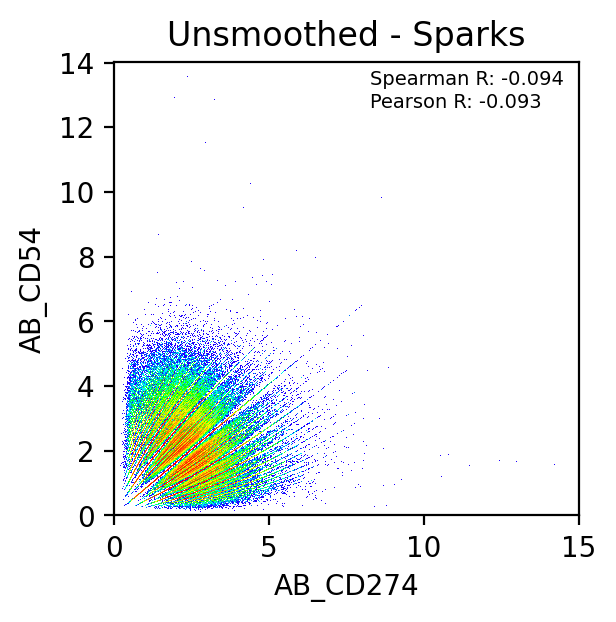

...

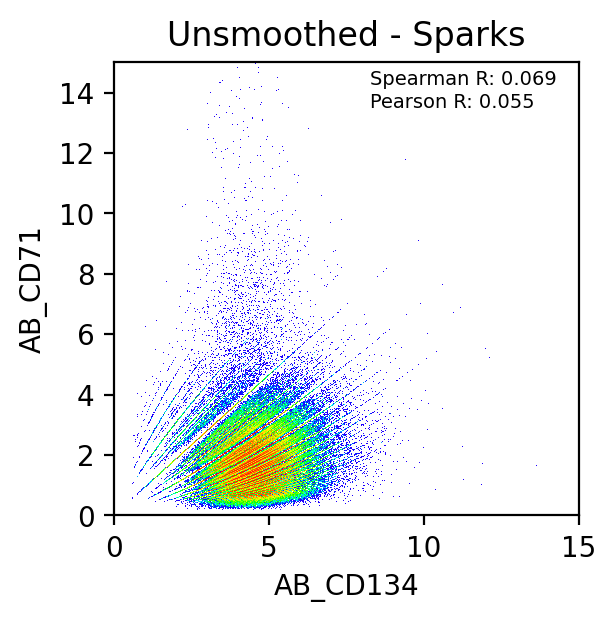

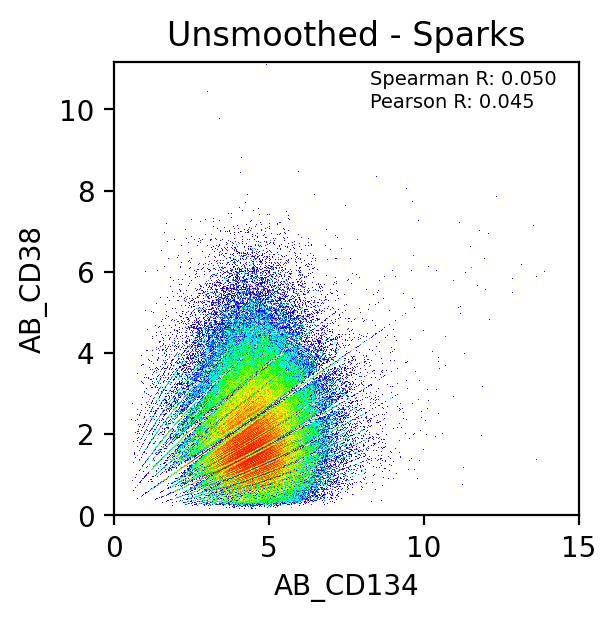

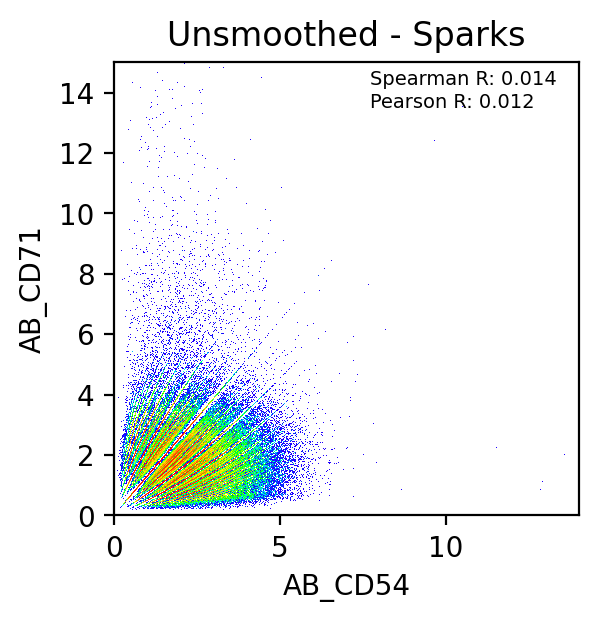

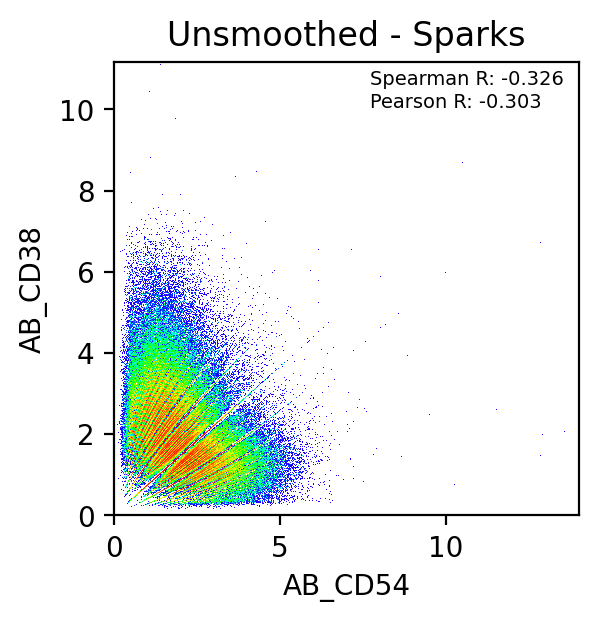

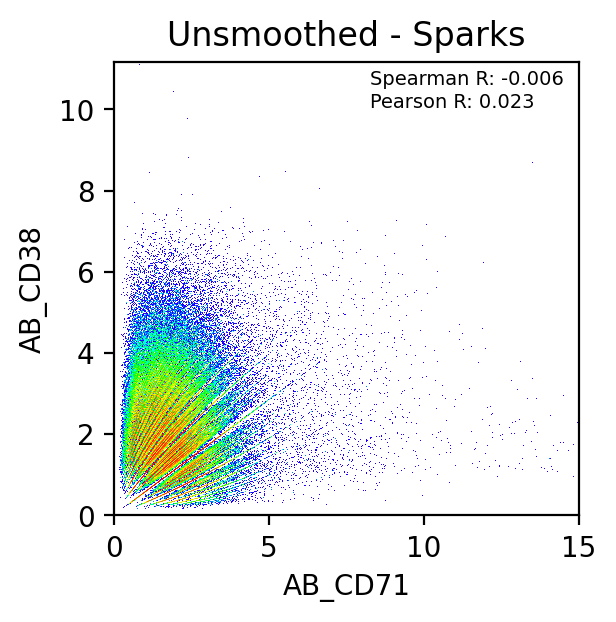

In [67]:
for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = unsmoothed_markers[p1]
            y = unsmoothed_markers[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title('Unsmoothed - Sparks')

In [24]:
# cmap = plt.cm.hsv
# cmaplist = [cmap(i) for i in range(cmap.N)]
# cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
# cmaplist.reverse()
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)
    
def gate(data, g1, g2, ind=None, vertical_gate=None, horizontal_gate=None, quadrant_gate=None,
         labfontsize=9, plot_labeled=False, upper_only=False, ax=None):
    
    
    if ax is None:
        fig = plt.figure(constrained_layout=True, figsize=(2., 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.95, top=.92)
        ax = fig.add_subplot(gs[0])

    if ind  is None:
        ind = pd.Series(np.array([True]*data.shape[0]), data.index)
    
    
    x = data.loc[ind, g1]
    y = data.loc[ind, g2]
    
    dsshow(pd.DataFrame({'x':x, 'y':y}), ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
    ax.set_xlabel(g1, fontsize=labfontsize)
    ax.set_ylabel(g2, fontsize=labfontsize)

    
    if vertical_gate is not None:
        xlim = ax.get_xlim()
        ax.hlines(y=vertical_gate['vthresh'], xmin=xlim[0], xmax=xlim[1], linestyle='--', color='k', linewidth=1)
        ax.set_xlim(xlim)
        
            
        initial_res = (data.loc[ind, g2]>vertical_gate['vthresh']).replace({True:vertical_gate['above_name'], False:vertical_gate['below_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
    elif horizontal_gate is not None:
        ylim = ax.get_ylim()
        ax.vlines(x=horizontal_gate['hthresh'], ymin=ylim[0], ymax=ylim[1], linestyle='--', color='k', linewidth=1)
        ax.set_ylim(ylim)
        
        initial_res = (data.loc[ind, g1]>horizontal_gate['hthresh']).replace({False:horizontal_gate['left_name'], True:horizontal_gate['right_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
        
        
    elif quadrant_gate is not None:
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
        if not upper_only:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=xlim[0]-1, xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=ylim[0]-1, ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)
        else:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=quadrant_gate['hthresh'], xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=quadrant_gate['vthresh'], ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)            
            

        indh = data.loc[ind, g1]> quadrant_gate['hthresh']
        indv = data.loc[ind, g2]> quadrant_gate['vthresh']
        final_res = ind.replace(False,np.nan)
        for hval,vval, lab in [[False, False, quadrant_gate['ll']], [True, False, quadrant_gate['lr']], [False, True, quadrant_gate['ul']], [True, True, quadrant_gate['ur']]]:
            tolab = (indh==hval) & (indv==vval)
            final_res.loc[tolab.index[tolab]] = lab
            
            
    if plot_labeled:
        fig = plt.figure(constrained_layout=True, figsize=(2.4, 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.8, top=.92)
        ax2 = fig.add_subplot(gs[0])
        dat = pd.concat([x,y,final_res], axis=1)
        dat.columns = [g1, g2, 'label']
        for (k,g) in dat.groupby('label'):
            ax2.scatter(g[g1], g[g2], label=k, s=.5, edgecolor='None')
        ax2.legend(bbox_to_anchor=(1,1), markerscale=3, fontsize=6)
        
        
        
    return(final_res, ax)

In [27]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated'])


Text(3.3, 6.5, 'Activated')

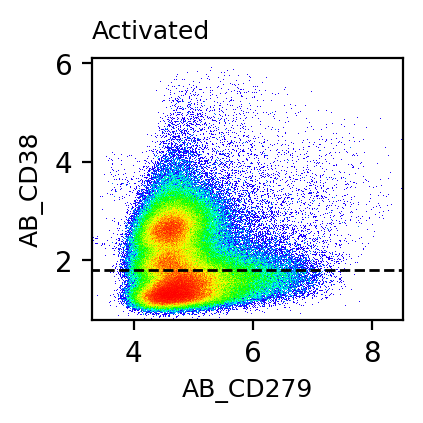

In [34]:
g1 = 'AB_CD279'
g2 = 'AB_CD38'   
gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
                      quadrant_gate={'vthresh':1.8, 'hthresh':2.5, 'ur':'MAIT', 'ul':'ab', 'll':'ab', 'lr':'ab'}, plot_labeled=False, upper_only=True)
ax.text(3.3,6.5, 'Activated', fontsize=9)
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

Text(6, 5, 'Activated')

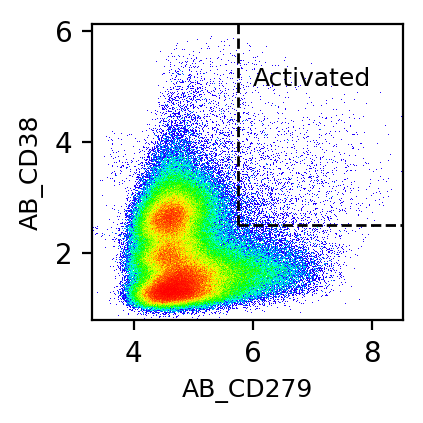

In [48]:
g1 = 'AB_CD279'
g2 = 'AB_CD38'   
gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
                      quadrant_gate={'vthresh':2.5, 'hthresh':5.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(6,5, 'Activated', fontsize=9)
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

In [50]:
gating['Activated'].value_counts()

Unactivated    334425
Activated        2314
Name: Activated, dtype: int64

In [51]:
outfn = os.path.join(outdir, 'ManualGatingActivation.Magic.20230111.tsv')
print(outfn)

../../../Data/PerDataset/Sparks2023/ManualGatingActivation.Magic.20230111.tsv


In [52]:
gating.to_csv(outfn, sep='\t')

## By lineage classes

In [92]:
lineage_gating = pd.read_csv(params.loc[dataset, 'manual_gating_fn'], index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

In [93]:
lineage_gating.value_counts()

gating     class
CD4_Naive  CD4      96784
CD4_CM     CD4      56439
CD4_EM     CD4      40883
CD8_EM     CD8      39647
CD8_Naive  CD8      29266
MAIT       Other    18065
CD8_TEMRA  CD8      16914
gdT        Other    14822
Treg       CD4       8146
CD8_CM     CD8       5187
CD4_TEMRA  CD4       4735
DP         Other     4408
DN         Other     1443
dtype: int64

In [94]:
lineage_gating['class'].value_counts()

CD4      206987
CD8       91014
Other     38738
Name: class, dtype: int64

CD4
CD8
Other


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

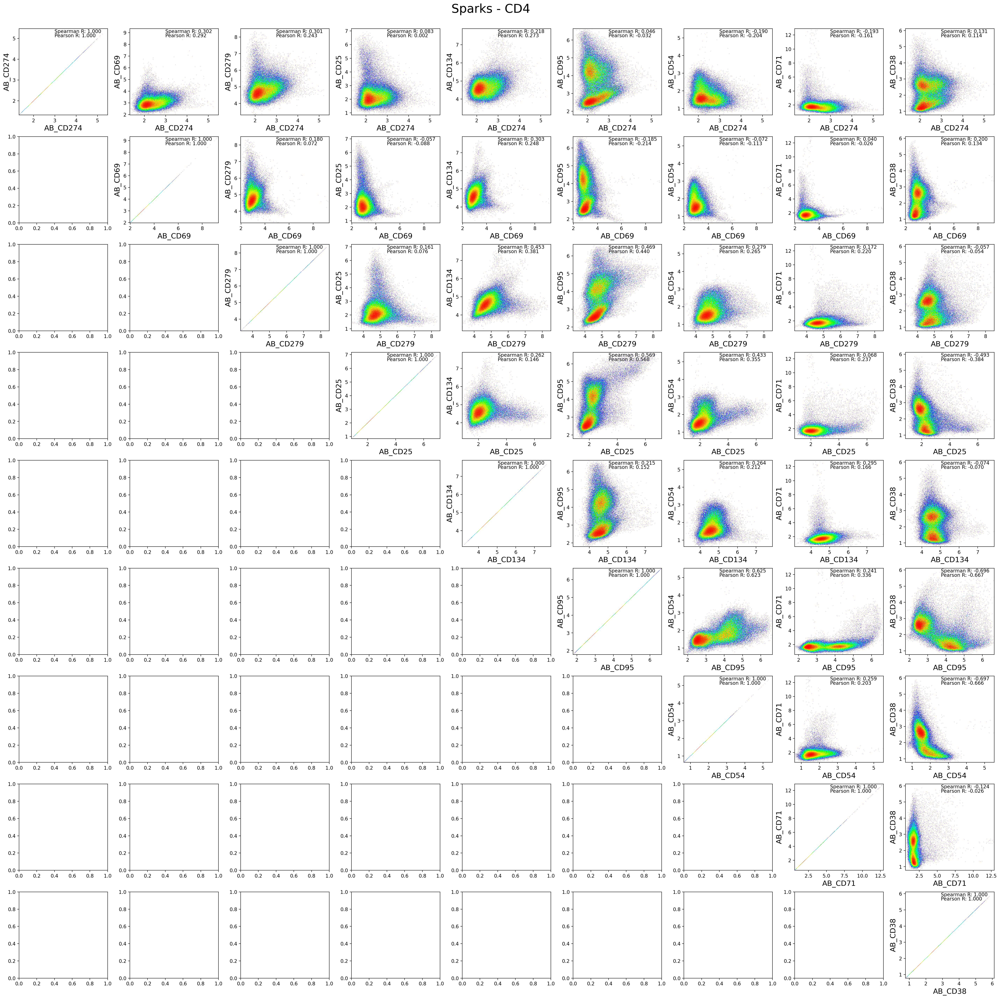

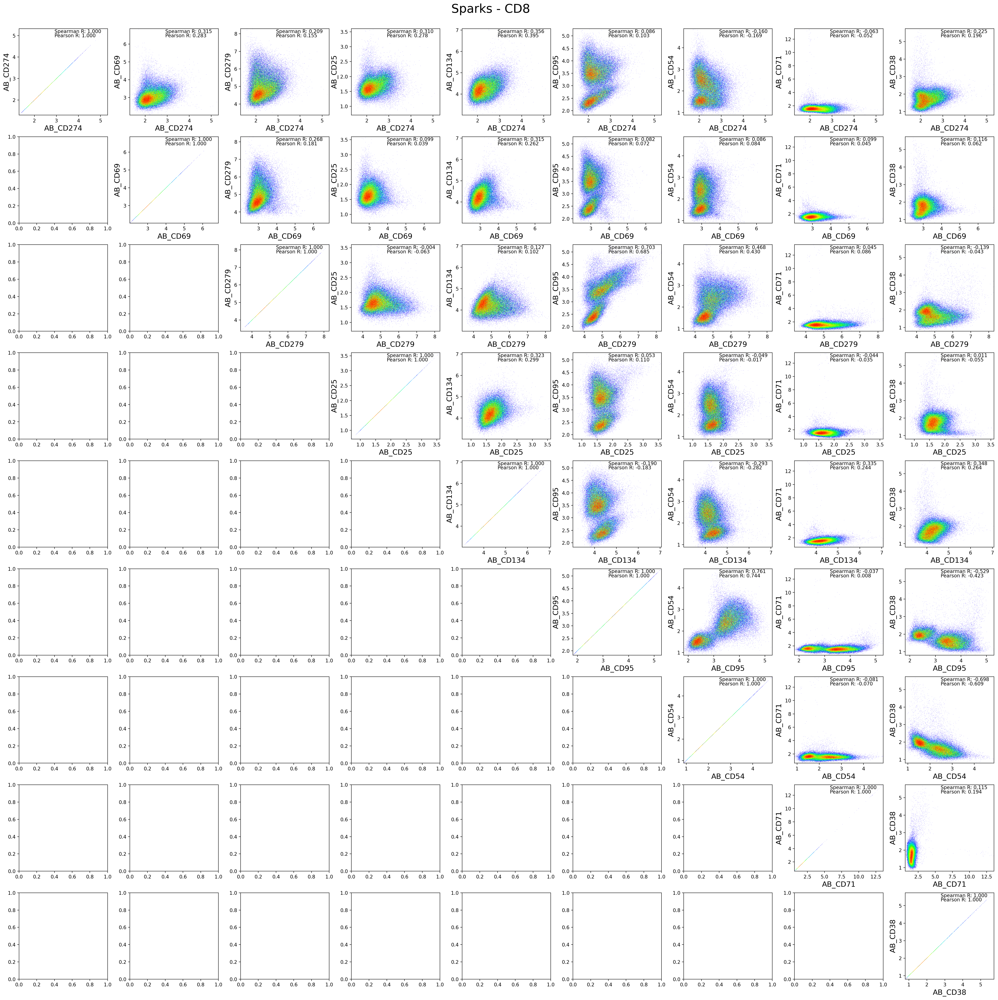

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


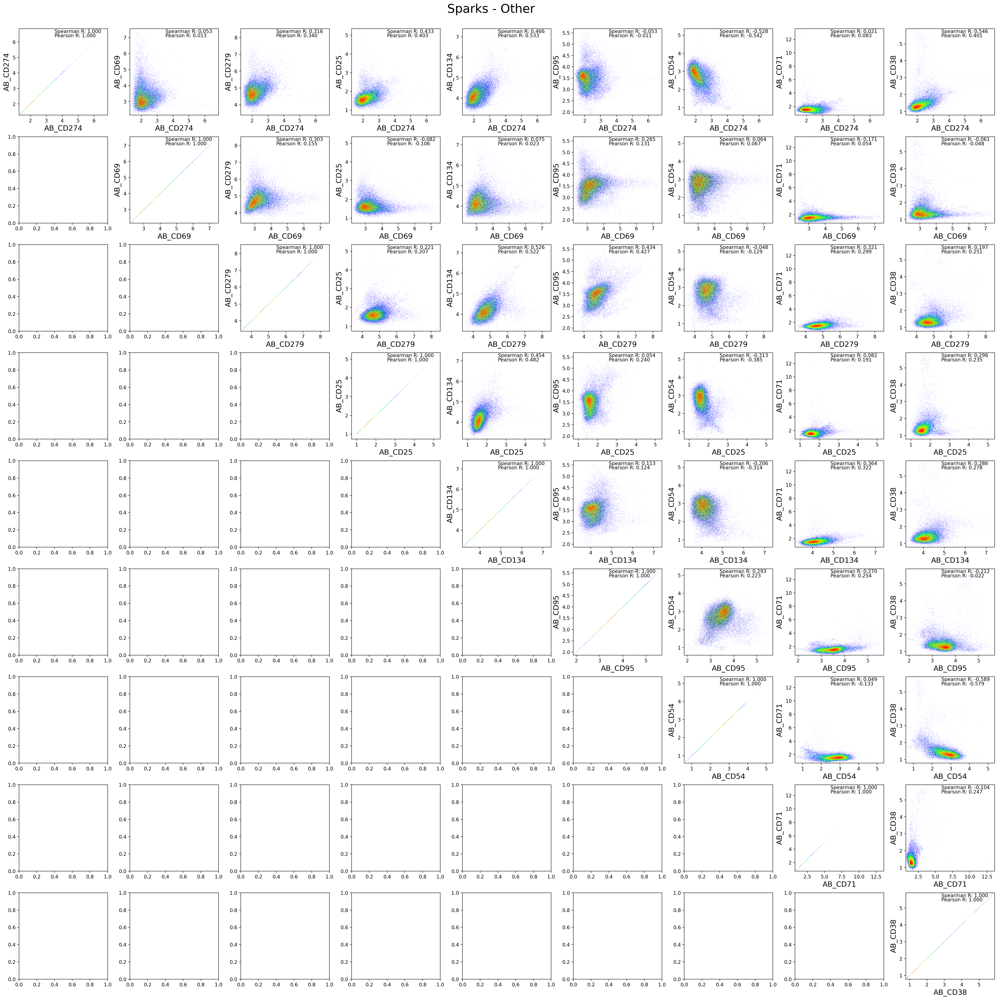

In [96]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    fontsize = 15
    nrows = len(markers_magic.columns)
    ncols = len(markers_magic.columns)
    fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                                   nrows = nrows, ncols = ncols, 
                            gridspec_kw = {'wspace' : 0.25, 'hspace' : 0.25})
    
    ind = lineage_gating[lineage_gating['class']==lineage].index
    for i, p1 in enumerate(markers_magic.columns):
        # print(i, p1)
        # i = i-1

        for j, p2 in enumerate(markers_magic.columns):
            # j = j-1
            if j >= i:
                # print(j, p1)
                ax = axes[i, j]
                x = markers_magic.loc[ind, p1]
                y = markers_magic.loc[ind, p2]

                r_p, _ = pearsonr(x, y)
                r_s, _ = spearmanr(x, y)

                # ax.scatter(x, y)
                dsshow(pd.DataFrame({'x':x, 'y':y}), 
                       ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
                # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
                ax.text(x = .4, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 10, transform=ax.transAxes)
                ax.text(x = .4, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 10, transform=ax.transAxes)
                ax.set_xlabel(p1, fontsize = fontsize)
                ax.set_ylabel(p2, fontsize = fontsize)
    plt.suptitle('%s - %s' % (dataset, lineage), y = 0.9, fontsize = fontsize + 10)

In [ ]:
lineage_gating['class'].unique():

array(['CD4', 'CD8', 'Other'], dtype=object)

In [200]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated_CD8', 'Activated_CD4', 
                                                          'Activated_Other', 'Class'])
gating['Class'] = lineage_gating.loc[gating.index, 'class']

In [257]:
lineage = 'CD8'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [258]:
gating['Activated_CD8'].value_counts()

Unactivated    90474
Activated        540
Name: Activated_CD8, dtype: int64

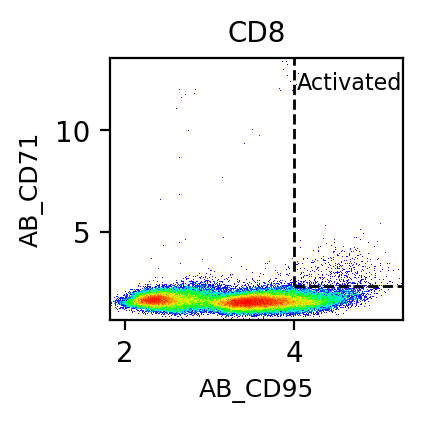

In [259]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_CD8'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2.3, 'hthresh':4, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(4.03,12, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD8.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD8.pdf'))

In [260]:
lineage = 'CD4'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [205]:
gating['Activated_CD4'].value_counts()

Series([], Name: Activated_CD4, dtype: int64)

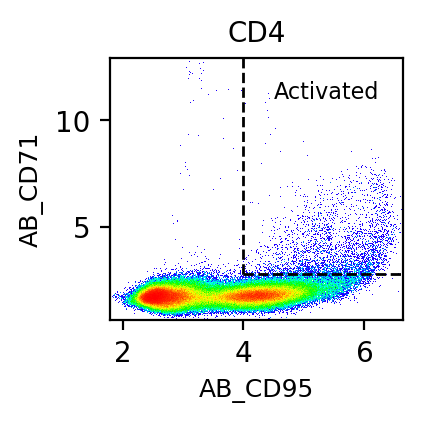

In [261]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_CD4'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2.75, 'hthresh':4, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(4.5,11, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD4.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD4.pdf'))

In [262]:
lineage = 'Other'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [225]:
gating['Activated_Other'].value_counts()

Series([], Name: Activated_Other, dtype: int64)

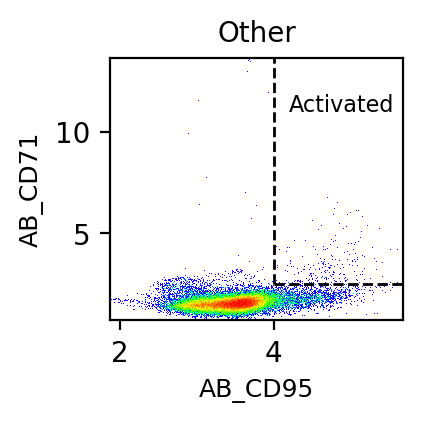

In [263]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_Other'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2.5, 'hthresh':4, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(4.2,11, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_Other.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_Other.pdf'))

In [229]:
gating['Activated_Other'].value_counts()

Unactivated    38500
Activated        238
Name: Activated_Other, dtype: int64

In [214]:
gating['Activated'] = np.nan

In [231]:
label = gating[['Activated_CD8', 'Activated_CD4', 'Activated_Other']].unstack().dropna().reset_index()
label.index = label['level_1']

In [ ]:
gating.loc[label.index, 'Activated'] = label[0]

In [235]:
label.shape

(336739, 3)

In [237]:
len(label.index.unique())

336739

In [233]:
label.head()

,level_0,level_1,0
level_1,,,
Batch1_COVFLU_CITE_multi5P03_AGGGTGACATTAGGCT-1,Activated_CD8,Batch1_COVFLU_CITE_multi5P03_AGGGTGACATTAGGCT-1,Unactivated
Batch1_COVFLU_CITE_multi5P01_ATCTACTCAAGAAAGG-1,Activated_CD8,Batch1_COVFLU_CITE_multi5P01_ATCTACTCAAGAAAGG-1,Unactivated
Batch1_COVFLU_CITE_multi5P03_TGTGTTTGTATATGAG-1,Activated_CD8,Batch1_COVFLU_CITE_multi5P03_TGTGTTTGTATATGAG-1,Unactivated
Batch1_COVFLU_CITE_multi5P02_TTTGCGCCATGAGCGA-1,Activated_CD8,Batch1_COVFLU_CITE_multi5P02_TTTGCGCCATGAGCGA-1,Unactivated
Batch1_COVFLU_CITE_multi5P02_CTACGTCTCACAAACC-1,Activated_CD8,Batch1_COVFLU_CITE_multi5P02_CTACGTCTCACAAACC-1,Unactivated


In [249]:
(gating.isna().sum(axis = 1)==2).value_counts()

True    336739
dtype: int64

In [248]:
gating

,Activated_CD8,Activated_CD4,Activated_Other,Class,Activated
Batch1_COVFLU_CITE_multi5P09_GCATGCGCAGCCTATA-1,NaN,Unactivated,NaN,CD4,Unactivated
Batch1_COVFLU_CITE_multi5P02_TTGTAGGCAGTATCTG-1,NaN,Unactivated,NaN,CD4,Unactivated
Batch1_COVFLU_CITE_multi5P02_GATGCTACAGCTTAAC-1,NaN,Unactivated,NaN,CD4,Unactivated
Batch1_COVFLU_CITE_multi5P03_AGGGTGACATTAGGCT-1,Unactivated,NaN,NaN,CD8,Unactivated
Batch1_COVFLU_CITE_multi5P10_GAACCTACAACGCACC-1,NaN,Unactivated,NaN,CD4,Unactivated
...,...,...,...,...,...
Batch3_COVFLU_CITE_multi5P16_TTCGAAGGTCTCTTTA-1,NaN,NaN,Unactivated,Other,Unactivated
Batch3_COVFLU_CITE_multi5P09_CTCGTACGTAGGACAC-1,NaN,Unactivated,NaN,CD4,Unactivated
Batch3_COVFLU_CITE_multi5P09_ACGGCCACAAGAAGAG-1,NaN,Unactivated,NaN,CD4,Unactivated
Batch3_COVFLU_CITE_multi5P07_GAGTCCGCACACAGAG-1,NaN,Unactivated,NaN,CD4,Unactivated


In [250]:
gating['Activated'].value_counts()

Unactivated    332449
Activated        4290
Name: Activated, dtype: int64

In [251]:
gating[['Class', 'Activated']].value_counts()

Class  Activated  
CD4    Unactivated    203475
CD8    Unactivated     90474
Other  Unactivated     38500
CD4    Activated        3512
CD8    Activated         540
Other  Activated         238
dtype: int64

In [254]:
outfn = os.path.join(outdir, 'ManualGatingActivationByLineage.Magic.20230112.tsv')
print(outfn)

../../../Data/PerDataset/Sparks2023/ManualGatingActivationByLineage.Magic.20230112.tsv


In [255]:
gating[['Class', 'Activated']].to_csv(outfn, sep='\t')

## By lineage classes (CD4 Conv, CD4 Treg, CD8 Conv, Other)

In [15]:
lineage_gating = pd.read_csv(params.loc[dataset, 'manual_gating_fn'], index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4 Conv'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4 Treg'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8 Conv'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

In [16]:
lineage_gating.value_counts()

gating     class   
CD4_Naive  CD4 Conv    96784
CD4_CM     CD4 Conv    56439
CD4_EM     CD4 Conv    40883
CD8_EM     CD8 Conv    39647
CD8_Naive  CD8 Conv    29266
MAIT       Other       18065
CD8_TEMRA  CD8 Conv    16914
gdT        Other       14822
Treg       CD4 Treg     8146
CD8_CM     CD8 Conv     5187
CD4_TEMRA  CD4 Conv     4735
DP         Other        4408
DN         Other        1443
dtype: int64

In [17]:
lineage_gating['class'].value_counts()

CD4 Conv    198841
CD8 Conv     91014
Other        38738
CD4 Treg      8146
Name: class, dtype: int64

CD4 Conv
CD8 Conv
CD4 Treg
Other


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

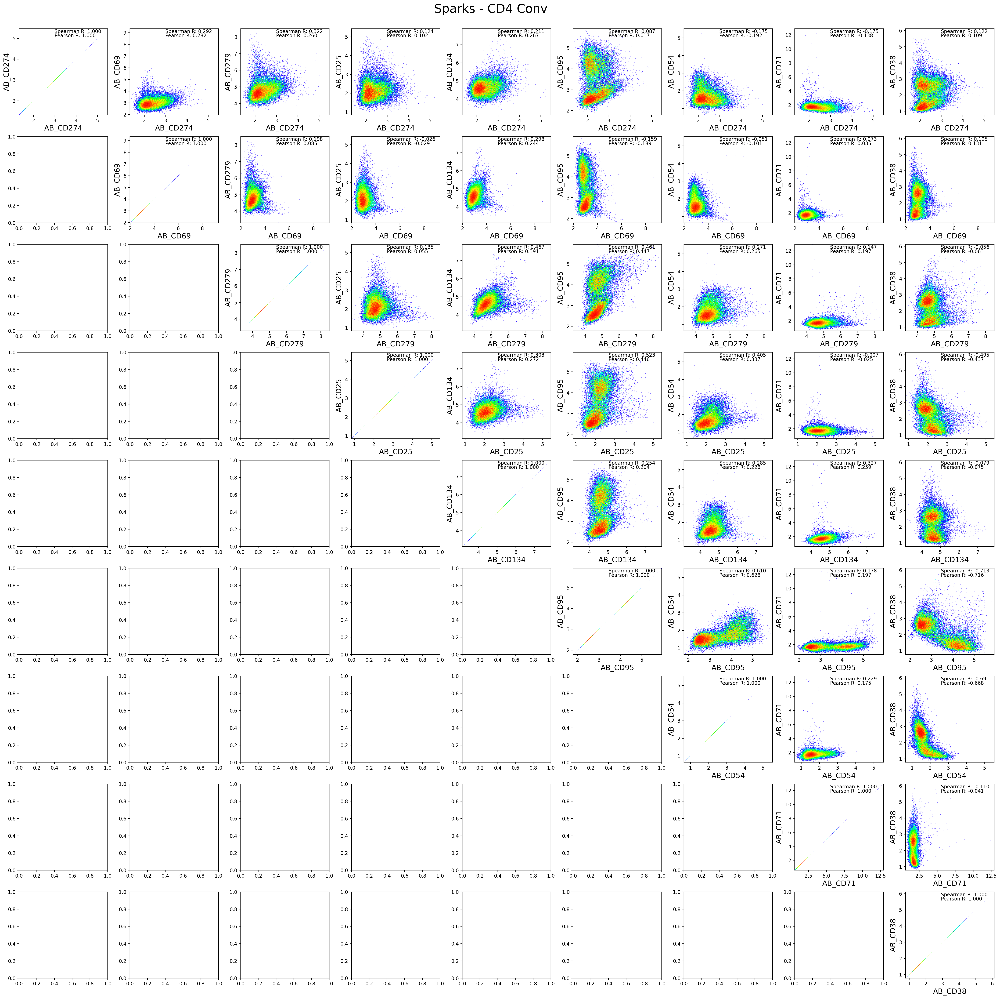

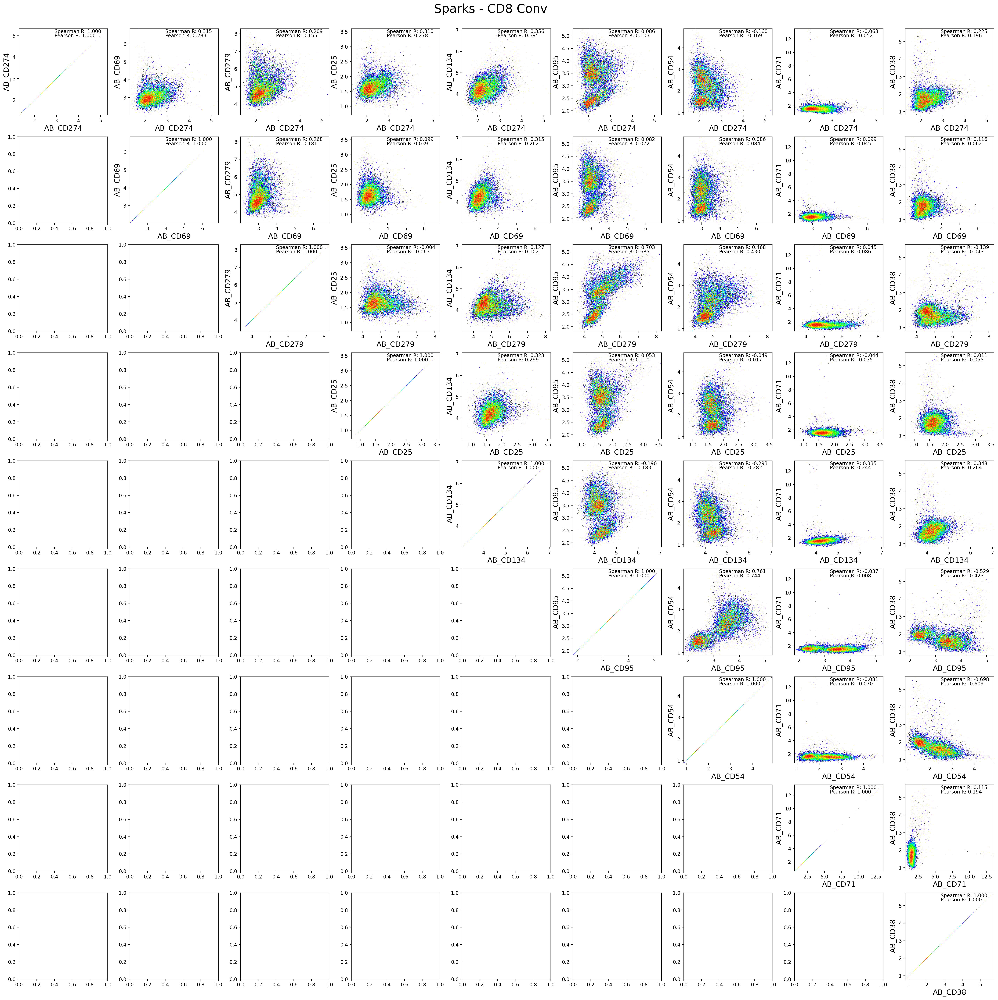

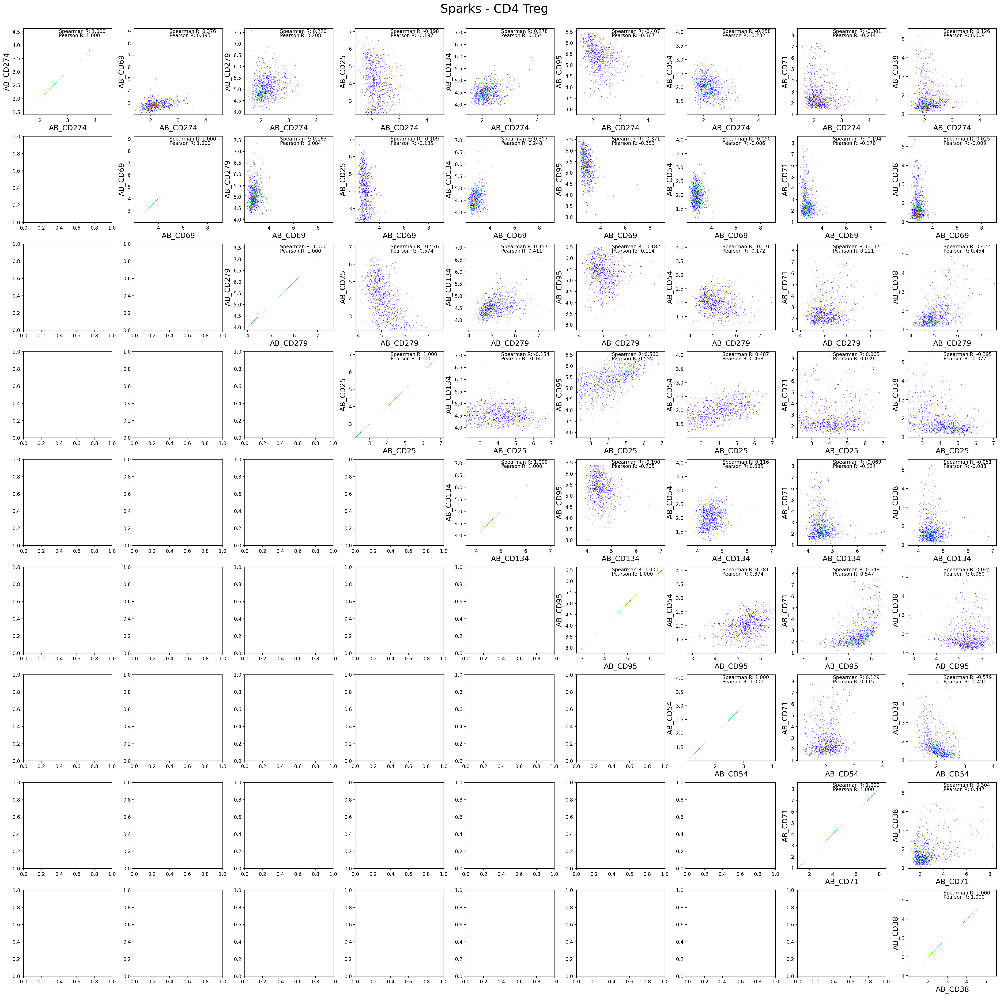

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


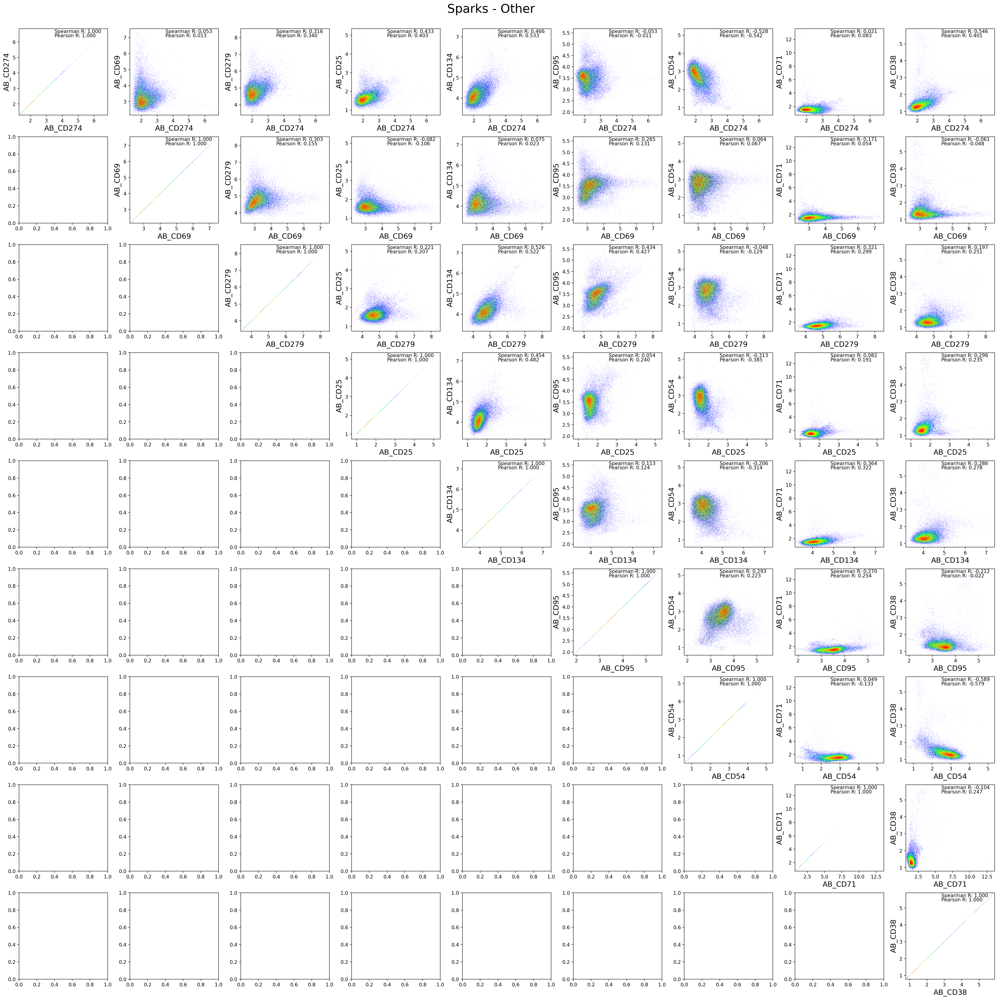

In [18]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    fontsize = 15
    nrows = len(markers_magic.columns)
    ncols = len(markers_magic.columns)
    fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                                   nrows = nrows, ncols = ncols, 
                            gridspec_kw = {'wspace' : 0.25, 'hspace' : 0.25})
    
    ind = lineage_gating[lineage_gating['class']==lineage].index
    for i, p1 in enumerate(markers_magic.columns):
        # print(i, p1)
        # i = i-1

        for j, p2 in enumerate(markers_magic.columns):
            # j = j-1
            if j >= i:
                # print(j, p1)
                ax = axes[i, j]
                x = markers_magic.loc[ind, p1]
                y = markers_magic.loc[ind, p2]

                r_p, _ = pearsonr(x, y)
                r_s, _ = spearmanr(x, y)

                # ax.scatter(x, y)
                dsshow(pd.DataFrame({'x':x, 'y':y}), 
                       ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
                # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
                ax.text(x = .4, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 10, transform=ax.transAxes)
                ax.text(x = .4, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 10, transform=ax.transAxes)
                ax.set_xlabel(p1, fontsize = fontsize)
                ax.set_ylabel(p2, fontsize = fontsize)
    plt.suptitle('%s - %s' % (dataset, lineage), y = 0.9, fontsize = fontsize + 10)

# Compare protein with TCAT usages

In [76]:
aim_assoc_geps = ['Early-Activation',
'ISG',
'BCL2-Survival',
'Treg',
'OX40/EBI3-Activation',
'Cytoskeleton',
'Th17',
'ICOS/CD38-Activation',
'Exhaustion',
'RGCC/MYADM',
'CCR10-Migration',
'CellCycle-S',
'Tfh-2',
'CTLA4+/CD38+-Activation',
'HeatShock',
'Tph',
'Multi-Cytokine',
'TIMD4/TIM3-Activation',
'Th17-2',
'Th2-2',
'Metallothionein',
'CellCycle-Late-S',
'CellCycle-G2M',
                   ]

In [77]:
cc_assoc_geps = ['CTLA4+/CD38+-Activation', 'Cytoskeleton', 'Early-Activation',
       'Exhaustion', 'HLA', 'ICOS/CD38-Activation', 'IL10/IL19-Secretion',
       'Metallothionein', 'OX40/EBI3-Activation', 'TIMD4/TIM3-Activation',
       'Th17-2', 'Tph']

In [73]:
gep_info = read_dataset_log('cGEP_Name')
rename_map = dict(zip(gep_info['cGep_Name'], gep_info['Short_Name']))


In [71]:
dataset = 'Sparks'

In [72]:
usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')

In [74]:
usage.columns = usage.columns.map(rename_map)
usage_norm = usage.div(usage.sum(axis=1), axis=0)


In [75]:
usage_norm

,CellCycle-G2M,Translation,HLA,ISG,Mito,Doublet-RBC,gdT-Blood,CellCycle-S,Cytotoxic,Doublet-Platelet,...,Tfh-2,OX40/EBI3-Activation,TXNIP/H1FX,YPEL5/JUNB,Doublet-Fibroblast,SOX4/TOX2,CD40LG/TXNIP,Tph,Exhaustion,Tfh-1
Batch1_COVFLU_CITE_multi5P09_GCATGCGCAGCCTATA-1,0.001249,9.765970e-02,0.002846,0.003858,0.068945,0.000825,0.009809,2.147168e-03,0.010658,0.003325,...,0.007928,0.005777,0.026110,0.094100,0.003461,0.013460,0.024564,0.002137,0.001426,0.010751
Batch1_COVFLU_CITE_multi5P02_TTGTAGGCAGTATCTG-1,0.000686,5.026169e-02,0.008290,0.005645,0.005134,0.001166,0.001956,8.756106e-03,0.002012,0.001555,...,0.006737,0.001269,0.026953,0.041199,0.015763,0.011500,0.125429,0.002181,0.003469,0.005613
Batch1_COVFLU_CITE_multi5P02_GATGCTACAGCTTAAC-1,0.001034,5.093182e-02,0.001123,0.011034,0.004890,0.000896,0.004094,4.694096e-03,0.004684,0.003022,...,0.005728,0.006820,0.038178,0.055920,0.002718,0.010659,0.025570,0.003850,0.004501,0.009170
Batch1_COVFLU_CITE_multi5P03_AGGGTGACATTAGGCT-1,0.000517,9.689799e-04,0.001890,0.000318,0.029614,0.000782,0.043625,1.519188e-03,0.112197,0.001017,...,0.002174,0.000681,0.003035,0.004169,0.000797,0.002823,0.005232,0.004740,0.003648,0.004476
Batch1_COVFLU_CITE_multi5P10_GAACCTACAACGCACC-1,0.009039,7.309449e-07,0.000027,0.000701,0.174035,0.000049,0.000230,2.413239e-07,0.000596,0.000088,...,0.000099,0.000126,0.000054,0.017681,0.004600,0.000030,0.022613,0.188464,0.020078,0.000025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Batch3_COVFLU_CITE_multi5P16_TTCGAAGGTCTCTTTA-1,0.001697,6.068974e-04,0.023222,0.000378,0.011362,0.000537,0.052489,1.297494e-02,0.077627,0.000748,...,0.001772,0.002028,0.003102,0.009841,0.000527,0.003356,0.005888,0.010479,0.044434,0.005269
Batch3_COVFLU_CITE_multi5P09_CTCGTACGTAGGACAC-1,0.002060,2.149576e-02,0.004124,0.001668,0.001146,0.000653,0.005318,2.272175e-03,0.008740,0.002636,...,0.055848,0.008406,0.018126,0.022572,0.001168,0.010036,0.009874,0.003678,0.002566,0.025706
Batch3_COVFLU_CITE_multi5P09_ACGGCCACAAGAAGAG-1,0.000874,2.540593e-02,0.001706,0.021973,0.001055,0.000998,0.007148,6.166932e-03,0.006936,0.002309,...,0.003520,0.017725,0.009164,0.009044,0.002343,0.004812,0.020372,0.006861,0.002804,0.010182
Batch3_COVFLU_CITE_multi5P07_GAGTCCGCACACAGAG-1,0.000872,1.374151e-03,0.000949,0.008469,0.000019,0.000454,0.001059,1.678706e-03,0.002277,0.000497,...,0.005833,0.018598,0.004408,0.013222,0.000976,0.056932,0.029195,0.002794,0.016688,0.091403


In [79]:
activation_geps = sorted(list(set(aim_assoc_geps).intersection(cc_assoc_geps)))
activation_geps

['CTLA4+/CD38+-Activation',
 'Cytoskeleton',
 'Early-Activation',
 'Exhaustion',
 'ICOS/CD38-Activation',
 'Metallothionein',
 'OX40/EBI3-Activation',
 'TIMD4/TIM3-Activation',
 'Th17-2',
 'Tph']

0 CTLA4+/CD38+-Activation
1 Cytoskeleton
2 Early-Activation
3 Exhaustion
4 ICOS/CD38-Activation
5 Metallothionein
6 OX40/EBI3-Activation
7 TIMD4/TIM3-Activation
8 Th17-2
9 Tph


Text(0.5, 0.9, 'Sparks')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

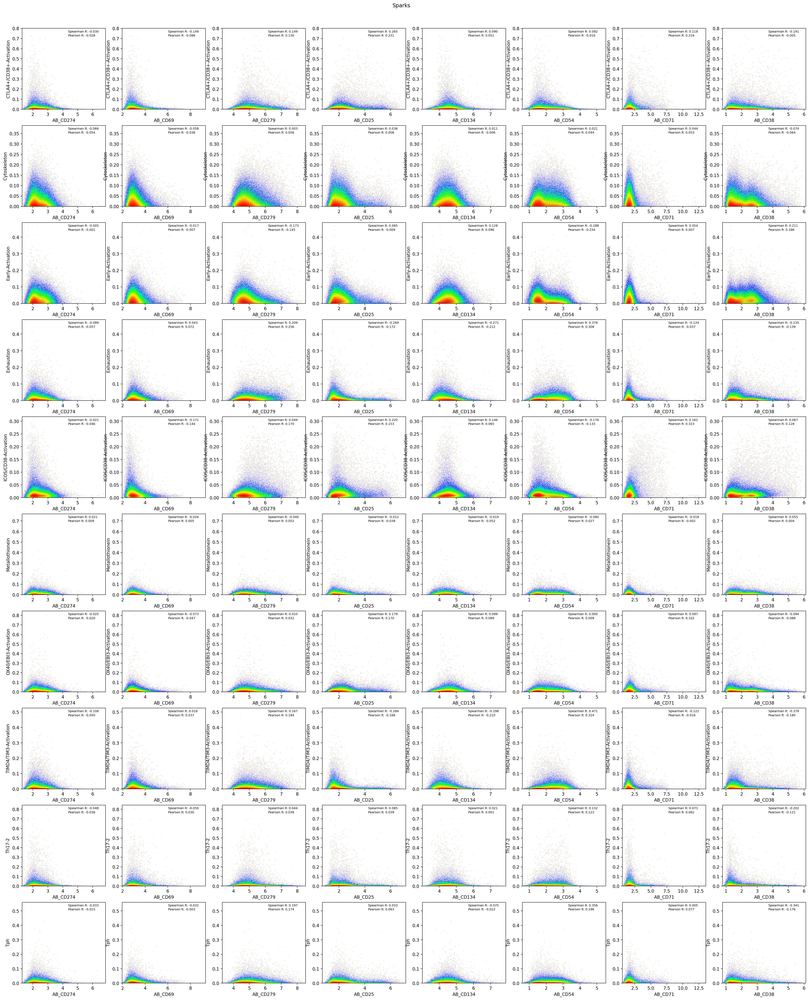

In [82]:
nrows = len(activation_geps)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(activation_geps)),
                                               nrows = nrows, ncols = ncols)

for i, gep in enumerate(activation_geps):
    print(i, gep)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # if j >= i:
        ax = axes[i, j]
        x = markers_magic[p2]
        y = usage_norm.loc[markers_magic.index, gep]

        r_p, _ = pearsonr(x, y)
        r_s, _ = spearmanr(x, y)

        # ax.scatter(x, y)
        dsshow(pd.DataFrame({'x':x, 'y':y}), 
               ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
        # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
        ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
        ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
        ax.set_xlabel(p2)
        ax.set_ylabel(gep)
plt.suptitle('Sparks',y = 0.9)